# Chronic Lymphocytic Leukemia (CLL) dataset
IAU Projekt ZS 2021/2022

Martiš, streda 19:00

Kuráň Matej, Mruzek Matúš

dataset 55

Skok na jednotlivé fázy: [1. fáza](#1.-fáza) [2. fáza](#2.-fáza)

----

# 1. fáza

1. Základný opis dát spolu s ich charakteristikami (5 bodov)

   Pre dosiahnutie plného počtu bodov uveďte:
   -  počet záznamov,
   -  počet atribútov,
   -  ich typy,
   -  pre zvolené významné atribúty ich distribúcie, základné deskriptívne štatistiky a pod.


2. Párová analýza dát (5 bodov)

  - Preskúmajte vzťahy medzi zvolenými dvojicami atribútov.
  - Identifikujte závislostí medzi dvojicami atribútov a závislosti medzi predikovanou premennou a ostatnými premennými.


3. Formulácia a štatistické overenie hypotéz o dátach (2 body)

  - Sformulujte dve hypotézy o dátach v kontexte zadanej predikčnej úlohy. Príkladom je napr. pacienti v zlepšenom stave majú v priemere inú (vyššiu/nižšiu) hodnotu nejakej látky alebo hormónu ako pacienti v nezlepšenom stave.
  - Sformulované hypotézy overte vhodne zvoleným štatistickým testom.


4. Identifikácia problémov v dátach s navrhnutým riešením (3 body)

  - Identifikujte problémy v dátach napr.: nevhodná štruktúra dát, duplicitné záznamy, nejednotné formáty, chýbajúce hodnoty, vychýlené hodnoty. V dátach sa môžu nachádzať aj iné, tu nevymenované problémy.

  - Navrhnuté riešenie prvotne realizujte na dátach. Problém s dátami môžete riešiť iteratívne v každej fáze aj vo všetkých fázach podľa potreby.
  
----

## 1. Časť

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import scipy.stats as stats
from datetime import datetime
from datetime import date
import matplotlib.pyplot as plt

pd.set_option('max_columns', None)

In [2]:
labor = pd.read_csv('055/labor.csv', sep='\t', header=0, index_col=0)
labor.head()

,alt,alp,erytrocyty,trombocyty,smoker,ast,leukocyty,weight,ssn,hemoglobin,hematokrit,indicator,name,er-cv,hbver,relationship,etytr
0,2.41434,47.66259,9.16778,9.06523,Y,56.18953,7.72328,77.10021,005-10-1507,8.01767,5.27468,1.0,Tim Jackson,56.94903,9.29432,single,8.69227
1,0.44643,36.09296,6.36529,5.48567,no,67.86284,7.69235,79.07111,886-08-5964,8.12416,7.76872,1.0,Michael Jones,30.36222,9.45606,single,6.40610
2,0.46287,83.91591,5.70281,5.04303,no,59.22675,7.89615,28.35109,536-56-1355,6.71651,5.73040,0.0,Maria Downs,54.24455,8.67153,single,9.25118
3,0.46506,65.22335,6.96113,7.66778,no,53.20236,6.13281,52.78382,303-87-5769,7.37614,6.28627,0.0,Kerri Clements,48.46886,6.56444,widowed,9.04800
4,0.35351,35.39184,4.94897,5.09294,yes,67.21219,5.55122,56.04014,610-52-3918,8.28312,9.69782,0.0,Penny Davis,57.47901,8.02456,nop,6.59900


In [3]:
profiles = pd.read_csv('055/profiles.csv', sep='\t', header=0, index_col=0)
profiles.head()

,blood_group,ssn,name,sex,birthdate,race,address,company,residence
0,O+,777-25-0553,Carla Joseph,F,22 May 1960,White,"21095 Misty Unions\nPamelaburgh, HI 00601",Moore-Gomez,"442 Robert Park\nNew Gerald, NJ 02818"
1,B+,147-57-3969,Justin Hutchinson,M,1970-09-05,White,"5263 Ashley Run\nSouth Ronaldbury, MT 84175",Castaneda LLC,"17822 Anderson Crossing\nMillsfurt, OH 76420"
2,B-,285-57-9782,Michael Davis,M,"02/03/1980, 00:00:00",White,"3540 Arias Prairie\nRandyburgh, CA 01782","Hardin, Shah and Watts","7580 Lynn Parkway\nLake Cynthiaburgh, KS 79966"
3,O-,554-39-9634,Danielle Johnson DDS,F,1907-07-14,White,"82279 Amanda Estate Suite 284\nRiceberg, NC 94919",Ellis Inc,"063 Tonya Estates Suite 741\nNew Andrewmouth, ..."
4,O-,039-90-8959,Diane Ochoa,F,"06/28/1910, 00:00:00",Black,USS Glover\nFPO AA 15009,"Ford, Baker and Adkins","89231 Johnson Walks\nNew Joseph, NH 21932"


#### Spojenie tabuliek labor a profiles 

In [4]:
merged_data = labor.merge(profiles, on='ssn', how='outer')
merged_data.head()

,alt,alp,erytrocyty,trombocyty,smoker,ast,leukocyty,weight,ssn,hemoglobin,hematokrit,indicator,name_x,er-cv,hbver,relationship,etytr,blood_group,name_y,sex,birthdate,race,address,company,residence
0,2.41434,47.66259,9.16778,9.06523,Y,56.18953,7.72328,77.10021,005-10-1507,8.01767,5.27468,1.0,Tim Jackson,56.94903,9.29432,single,8.69227,B-,Tim Jackson,M,1933-08-19,Hawaiian,"7743 Whitney Field\nNorth Kristinaborough, AK ...",Nelson LLC,51743 Ramos Plaza Apt. 013\nNew Christophermou...
1,0.52600,25.44736,6.39544,5.36393,yes,33.06488,4.59519,54.86711,005-10-1507,8.48561,5.24169,0.0,Tim Jackson,55.89929,9.03588,widowed,7.81258,B-,Tim Jackson,M,1933-08-19,Hawaiian,"7743 Whitney Field\nNorth Kristinaborough, AK ...",Nelson LLC,51743 Ramos Plaza Apt. 013\nNew Christophermou...
2,0.44887,11.49107,6.17123,6.18092,Y,29.36710,6.17309,48.94474,005-10-1507,8.69126,7.81749,0.0,Tim Jackson,49.61996,8.31727,single,8.65872,B-,Tim Jackson,M,1933-08-19,Hawaiian,"7743 Whitney Field\nNorth Kristinaborough, AK ...",Nelson LLC,51743 Ramos Plaza Apt. 013\nNew Christophermou...
3,0.44643,36.09296,6.36529,5.48567,no,67.86284,7.69235,79.07111,886-08-5964,8.12416,7.76872,1.0,Michael Jones,30.36222,9.45606,single,6.40610,A-,Michael Jones,M,"07/16/1981, 00:00:00",White,"305 Ramirez Junctions Suite 661\nEast Ashlee, ...","Jones, Bennett and Cruz",2221 Landry Expressway Apt. 191\nSouth Micheal...
4,0.25791,58.92836,5.54060,5.27504,yes,59.05766,5.62712,37.28702,886-08-5964,7.51701,8.18631,0.0,Michael Jones,39.95466,6.77664,nop,7.04489,A-,Michael Jones,M,"07/16/1981, 00:00:00",White,"305 Ramirez Junctions Suite 661\nEast Ashlee, ...","Jones, Bennett and Cruz",2221 Landry Expressway Apt. 191\nSouth Micheal...


#### Odstránenie duplicitných stĺpcov

In [5]:
(merged_data.name_x != merged_data.name_y).sum()

0

In [6]:
merged_data = merged_data.drop(columns='name_y').rename(columns={'name_x':'name'})

### 1.1 Počet záznamov

In [7]:
len(labor.index)

9961

In [8]:
len(profiles.index)

3138

#### Počet všetkých záznamov je:

In [9]:
len(merged_data)

9961

### 1.2 Počet atribútov

In [10]:
len(labor.columns)

17

In [11]:
len(profiles.columns)

9

#### Počet všetkých atribútov je:

In [12]:
len(merged_data.columns)

24

### 1.3 Typy atribútov

In [13]:
labor.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9961 entries, 0 to 9960
Data columns (total 17 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   alt           9931 non-null   float64
 1   alp           9930 non-null   float64
 2   erytrocyty    9931 non-null   float64
 3   trombocyty    9931 non-null   float64
 4   smoker        9961 non-null   object 
 5   ast           9931 non-null   float64
 6   leukocyty     9930 non-null   float64
 7   weight        9961 non-null   float64
 8   ssn           9961 non-null   object 
 9   hemoglobin    9931 non-null   float64
 10  hematokrit    9931 non-null   float64
 11  indicator     9961 non-null   float64
 12  name          9961 non-null   object 
 13  er-cv         9931 non-null   float64
 14  hbver         9930 non-null   float64
 15  relationship  9961 non-null   object 
 16  etytr         9930 non-null   float64
dtypes: float64(13), object(4)
memory usage: 1.4+ MB


In [14]:
profiles.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3138 entries, 0 to 3137
Data columns (total 9 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   blood_group  3138 non-null   object
 1   ssn          3138 non-null   object
 2   name         3138 non-null   object
 3   sex          3138 non-null   object
 4   birthdate    3138 non-null   object
 5   race         3138 non-null   object
 6   address      3138 non-null   object
 7   company      3138 non-null   object
 8   residence    3138 non-null   object
dtypes: object(9)
memory usage: 245.2+ KB


#### Atribúty sú typov:

In [15]:
merged_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9961 entries, 0 to 9960
Data columns (total 24 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   alt           9931 non-null   float64
 1   alp           9930 non-null   float64
 2   erytrocyty    9931 non-null   float64
 3   trombocyty    9931 non-null   float64
 4   smoker        9961 non-null   object 
 5   ast           9931 non-null   float64
 6   leukocyty     9930 non-null   float64
 7   weight        9961 non-null   float64
 8   ssn           9961 non-null   object 
 9   hemoglobin    9931 non-null   float64
 10  hematokrit    9931 non-null   float64
 11  indicator     9961 non-null   float64
 12  name          9961 non-null   object 
 13  er-cv         9931 non-null   float64
 14  hbver         9930 non-null   float64
 15  relationship  9961 non-null   object 
 16  etytr         9930 non-null   float64
 17  blood_group   9961 non-null   object 
 18  sex           9961 non-null 

### 1.4 Deskriptívne štatistiky

In [16]:
labor.describe(include='all')

,alt,alp,erytrocyty,trombocyty,smoker,ast,leukocyty,weight,ssn,hemoglobin,hematokrit,indicator,name,er-cv,hbver,relationship,etytr
count,9931.000000,9930.000000,9931.000000,9931.000000,9961,9931.000000,9930.000000,9961.000000,9961,9931.000000,9931.000000,9961.000000,9961,9931.000000,9930.000000,9961,9930.000000
unique,NaN,NaN,NaN,NaN,4,NaN,NaN,NaN,3138,NaN,NaN,NaN,3078,NaN,NaN,6,NaN
top,NaN,NaN,NaN,NaN,no,NaN,NaN,NaN,839-51-4689,NaN,NaN,NaN,Melissa Garcia,NaN,NaN,married,NaN
freq,NaN,NaN,NaN,NaN,5489,NaN,NaN,NaN,5,NaN,NaN,NaN,13,NaN,NaN,2570,NaN
mean,1.599338,67.135307,7.637183,6.391385,NaN,50.700209,6.834541,69.697830,NaN,6.851952,6.851529,0.640598,NaN,49.306906,8.078577,NaN,7.644743
std,3.547398,20.698008,1.506321,1.745609,NaN,13.233297,1.006680,35.353764,NaN,0.992378,0.998617,0.479849,NaN,13.511759,1.215946,NaN,1.501712
min,0.000000,0.000000,2.583640,0.293720,NaN,0.000000,2.849550,-73.987940,NaN,2.636480,3.079190,0.000000,NaN,0.000000,2.047440,NaN,0.000000
25%,0.460690,55.741780,6.513030,5.183500,NaN,41.578565,6.160493,45.958540,NaN,6.180330,6.184955,0.000000,NaN,39.998415,7.280980,NaN,6.897400
50%,0.776670,74.352805,7.732810,6.176010,NaN,50.682410,6.835335,69.971170,NaN,6.855240,6.853900,1.000000,NaN,49.597150,8.084565,NaN,7.826715
75%,1.503220,82.940605,8.679175,7.447880,NaN,59.654665,7.518682,93.143610,NaN,7.532580,7.518560,1.000000,NaN,58.313545,8.864550,NaN,8.632370


In [17]:
profiles.describe(include='all')

,blood_group,ssn,name,sex,birthdate,race,address,company,residence
count,3138,3138,3138,3138,3138,3138,3138,3138,3138
unique,8,3138,3078,2,3115,8,3138,2940,3138
top,B+,777-25-0553,Melissa Garcia,F,"03/05/1946, 00:00:00",White,"21095 Misty Unions\nPamelaburgh, HI 00601",White Inc,"442 Robert Park\nNew Gerald, NJ 02818"
freq,409,1,4,1606,2,1512,1,6,1


#### Deskriptívne štatistíky sú:

In [18]:
merged_data.describe(include='all')

,alt,alp,erytrocyty,trombocyty,smoker,ast,leukocyty,weight,ssn,hemoglobin,hematokrit,indicator,name,er-cv,hbver,relationship,etytr,blood_group,sex,birthdate,race,address,company,residence
count,9931.000000,9930.000000,9931.000000,9931.000000,9961,9931.000000,9930.000000,9961.000000,9961,9931.000000,9931.000000,9961.000000,9961,9931.000000,9930.000000,9961,9930.000000,9961,9961,9961,9961,9961,9961,9961
unique,NaN,NaN,NaN,NaN,4,NaN,NaN,NaN,3138,NaN,NaN,NaN,3078,NaN,NaN,6,NaN,8,2,3115,8,3138,2940,3138
top,NaN,NaN,NaN,NaN,no,NaN,NaN,NaN,839-51-4689,NaN,NaN,NaN,Melissa Garcia,NaN,NaN,married,NaN,B+,F,26 Oct 1979,White,79212 Cynthia Walk Suite 033\nNorth Rebeccaber...,White Inc,"4275 Lawrence Track Apt. 974\nEast Pamela, NE ..."
freq,NaN,NaN,NaN,NaN,5489,NaN,NaN,NaN,5,NaN,NaN,NaN,13,NaN,NaN,2570,NaN,1303,5106,7,4798,5,20,5
mean,1.599338,67.135307,7.637183,6.391385,NaN,50.700209,6.834541,69.697830,NaN,6.851952,6.851529,0.640598,NaN,49.306906,8.078577,NaN,7.644743,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,3.547398,20.698008,1.506321,1.745609,NaN,13.233297,1.006680,35.353764,NaN,0.992378,0.998617,0.479849,NaN,13.511759,1.215946,NaN,1.501712,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,0.000000,0.000000,2.583640,0.293720,NaN,0.000000,2.849550,-73.987940,NaN,2.636480,3.079190,0.000000,NaN,0.000000,2.047440,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,0.460690,55.741780,6.513030,5.183500,NaN,41.578565,6.160493,45.958540,NaN,6.180330,6.184955,0.000000,NaN,39.998415,7.280980,NaN,6.897400,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,0.776670,74.352805,7.732810,6.176010,NaN,50.682410,6.835335,69.971170,NaN,6.855240,6.853900,1.000000,NaN,49.597150,8.084565,NaN,7.826715,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,1.503220,82.940605,8.679175,7.447880,NaN,59.654665,7.518682,93.143610,NaN,7.532580,7.518560,1.000000,NaN,58.313545,8.864550,NaN,8.632370,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Vysvetlivky jednotlivých polí
- **ALT** - [Alanine transaminase](https://en.wikipedia.org/wiki/Alanine_transaminase)
- **ALP** - [Alkaline phosphatase](https://en.wikipedia.org/wiki/Alkaline_phosphatase)
- **erytrocyty** - [červené krvinky](https://en.wikipedia.org/wiki/Red_blood_cell)
- **trombocyty** - [krvné doštičky](https://en.wikipedia.org/wiki/Platelet)
- **smoker** - fajčiar (áno/nie)
- **AST** - [Aspartate transaminase](https://en.wikipedia.org/wiki/Aspartate_transaminase)
- **leukocyty** - [biele krvinky](https://en.wikipedia.org/wiki/White_blood_cell)
- **weight** - váha (pravdepodobne v kg)
- **SSN** - [Social Security number](https://en.wikipedia.org/wiki/Social_Security_number) (niečo ako ID osoby)
- **hemoglobin** - [hemoglobín](https://en.wikipedia.org/wiki/Hemoglobin)
- **hematokrit** - [hematokrit](https://en.wikipedia.org/wiki/Hematocrit) - pomer zväčša červených krviniek k celkovému objemu krvi
- **indicator** - či sa môže predĺžiť interval vyšetrení? (áno/nie)
- **name** - meno
- **er-cv** - ???
- **hbver** - hepatitída typu B
- **relationship** - vzťah (slobodný, vo vzťahu, rozvedený, ovdovený, oddelený, neuvedené)
- **etytr** - ???

Možný zdroj: http://www.ousa.sk/_img/Documents/laboratorne_sluzby.pdf

ALT a AST sa zvyknú uvádzať aj ako pomer ([AST/ALT ratio](https://en.wikipedia.org/wiki/AST/ALT_ratio))"

## 4. Časť

### 4.1 Chýbajúce hodnoty

In [19]:
merged_data.isnull().sum()

alt             30
alp             31
erytrocyty      30
trombocyty      30
smoker           0
ast             30
leukocyty       31
weight           0
ssn              0
hemoglobin      30
hematokrit      30
indicator        0
name             0
er-cv           30
hbver           31
relationship     0
etytr           31
blood_group      0
sex              0
birthdate        0
race             0
address          0
company          0
residence        0
dtype: int64

In [20]:
merged_data.isnull().sum(axis=1).value_counts()

0    9632
1     324
2       5
dtype: int64

In [21]:
merged_data.isnull().any(axis=1).sum() / len(labor)

0.03302881236823612

#### Keďže je chýbajúcich hodnôt málo, iba 3 percentá, rozhodli sme sa ich neriešiť

### 4.2 Duplicitné záznamy

In [22]:
duplicates = merged_data.duplicated()
duplicates = duplicates[duplicates == True]
merged_data.iloc[duplicates.index]

,alt,alp,erytrocyty,trombocyty,smoker,ast,leukocyty,weight,ssn,hemoglobin,hematokrit,indicator,name,er-cv,hbver,relationship,etytr,blood_group,sex,birthdate,race,address,company,residence
144,0.82820,66.53598,7.48618,6.35944,no,51.90587,7.45633,152.73329,421-48-0212,7.53140,7.45188,0.0,Michael Ward,60.05462,8.51524,divoced,6.33008,O-,M,24 Feb 1963,Asian,"671 Price Mission\nDanielside, TX 05656",Ferguson Group,"19432 Dylan Rest Apt. 172\nEast Amanda, HI 36040"
152,0.71677,69.57001,7.60434,7.14793,no,62.56141,5.85842,87.76027,615-90-1736,7.28183,6.06148,0.0,Regina Gonzalez,35.61604,7.12387,single,5.66992,O-,F,1986/03/26,Black,"6292 Anthony Summit Apt. 813\nJessicaburgh, MO...","Little, Lucero and Scott","053 Clark Throughway\nWest Thomas, CT 17494"
212,0.31874,19.57187,4.79275,4.42925,no,43.39697,7.44301,68.47899,259-36-4719,8.49335,6.27524,0.0,Tonya Brown,74.28439,9.69171,separated,7.86736,O+,F,1931-09-10,Indian,"4042 Kenneth Radial Apt. 538\nChristinemouth, ...",Lawrence-Murphy,"349 Day Forges\nPort Debra, MS 14593"
473,0.26328,81.11856,5.57514,6.17032,no,55.25831,7.07074,78.95113,554-06-3687,6.57205,6.41718,0.0,Andrew Odom,46.04290,7.26408,married,7.20003,B+,M,1970/05/13,White,"PSC 8407, Box 5310\nAPO AE 81216",Murillo-Edwards,"617 Crystal Plaza\nNewtonside, TX 36971"
496,6.03619,69.35517,10.25949,7.46050,Y,53.10652,6.31842,109.39284,811-67-9071,7.26694,8.52862,1.0,Mrs. Danielle Mercado,65.29146,8.72220,widowed,9.89956,A-,F,"10/17/1907, 00:00:00",Asian,"286 Nancy Court\nWandamouth, PA 28507",Smith Group,"9563 Hawkins Greens Apt. 486\nWoodfort, TN 50833"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9057,0.44894,81.54321,6.65888,9.63997,no,41.39160,7.71802,97.52921,899-07-1525,6.08718,5.14574,1.0,Regina Hoffman,53.97978,6.91281,divoced,7.50444,O+,F,08 Jul 1941,White,"888 Troy Gateway Apt. 665\nLake Gabriel, TX 34076",Ruiz-Cruz,"83982 Coleman Light Apt. 090\nWest Jason, KS 8..."
9204,3.02227,80.03922,9.47182,5.87824,no,49.34035,4.93781,33.00686,312-49-7226,6.52707,7.90717,1.0,Walter Anderson,18.46991,9.49221,nop,8.16858,B+,M,1992-01-19,White,"3128 Ayala Neck Apt. 964\nDerekland, NY 30031",Gray and Sons,"1603 Glenn Circles Apt. 845\nLake John, CA 51400"
9521,1.25036,72.78810,8.40919,3.89008,no,59.49083,6.35930,28.93603,386-50-5733,7.12631,7.42230,0.0,Jason Gaines,66.57584,6.09663,separated,4.97152,A-,M,1944/09/19,Asian,USNS Mcpherson\nFPO AP 36495,Mcpherson-Watkins,"18589 Cardenas Club Apt. 205\nNorth Carol, GA ..."
9564,0.24310,92.19565,5.95699,5.08751,no,49.01636,4.84424,40.16161,437-24-6070,6.36559,7.40538,1.0,Martha Richardson,33.44217,11.46972,nop,6.06433,A+,F,19 Nov 1991,White,"867 Michaela Mountains\nNew Reneestad, IN 97551",Smith-Kaiser,"902 Hahn Cliff\nPort Amandaborough, KY 80819"


#### Všetky duplicitné záznamy sme odstránili

In [23]:
merged_data = merged_data.drop_duplicates()

### 4.3 Nejednotné formáty

#### Hodnoty v stĺpci smoker sme zemili na typ boolean

In [24]:
merged_data.smoker.value_counts()

no     5429
Y      1965
yes    1941
N       527
Name: smoker, dtype: int64

In [25]:
merged_data['smoker'] = merged_data['smoker'].replace({'yes' : True, 'Y' : True, 'no' : False, 'N' : False})
merged_data.smoker.value_counts()

False    5956
True     3906
Name: smoker, dtype: int64

#### Zjednotili sme rovnaké hodnoty s rôznymi formátmi

In [26]:
merged_data.race.value_counts()

White       4747
Black       2511
Asian       1023
Indian       514
Hawaiian     503
black        322
blsck        144
white         98
Name: race, dtype: int64

In [27]:
merged_data['race'] = merged_data['race'].replace({'black' : 'Black', 'blsck' : 'Black', 'white' : 'White'})
merged_data.race.value_counts()

White       4845
Black       2977
Asian       1023
Indian       514
Hawaiian     503
Name: race, dtype: int64

In [28]:
merged_data['birthdate'] = pd.to_datetime(merged_data['birthdate'])
merged_data['birthdate'].head()

0   1933-08-19
1   1933-08-19
2   1933-08-19
3   1981-07-16
4   1981-07-16
Name: birthdate, dtype: datetime64[ns]

#### Zistili sme aj vek pacientov

In [29]:
def calculate_age(born):
    today = date.today()
    return today.year - born.year - ((today.month, today.day) < (born.month, born.day))


In [30]:
merged_data['age'] = merged_data['birthdate'].apply(calculate_age)
merged_data.head()

,alt,alp,erytrocyty,trombocyty,smoker,ast,leukocyty,weight,ssn,hemoglobin,hematokrit,indicator,name,er-cv,hbver,relationship,etytr,blood_group,sex,birthdate,race,address,company,residence,age
0,2.41434,47.66259,9.16778,9.06523,True,56.18953,7.72328,77.10021,005-10-1507,8.01767,5.27468,1.0,Tim Jackson,56.94903,9.29432,single,8.69227,B-,M,1933-08-19,Hawaiian,"7743 Whitney Field\nNorth Kristinaborough, AK ...",Nelson LLC,51743 Ramos Plaza Apt. 013\nNew Christophermou...,88
1,0.52600,25.44736,6.39544,5.36393,True,33.06488,4.59519,54.86711,005-10-1507,8.48561,5.24169,0.0,Tim Jackson,55.89929,9.03588,widowed,7.81258,B-,M,1933-08-19,Hawaiian,"7743 Whitney Field\nNorth Kristinaborough, AK ...",Nelson LLC,51743 Ramos Plaza Apt. 013\nNew Christophermou...,88
2,0.44887,11.49107,6.17123,6.18092,True,29.36710,6.17309,48.94474,005-10-1507,8.69126,7.81749,0.0,Tim Jackson,49.61996,8.31727,single,8.65872,B-,M,1933-08-19,Hawaiian,"7743 Whitney Field\nNorth Kristinaborough, AK ...",Nelson LLC,51743 Ramos Plaza Apt. 013\nNew Christophermou...,88
3,0.44643,36.09296,6.36529,5.48567,False,67.86284,7.69235,79.07111,886-08-5964,8.12416,7.76872,1.0,Michael Jones,30.36222,9.45606,single,6.40610,A-,M,1981-07-16,White,"305 Ramirez Junctions Suite 661\nEast Ashlee, ...","Jones, Bennett and Cruz",2221 Landry Expressway Apt. 191\nSouth Micheal...,40
4,0.25791,58.92836,5.54060,5.27504,True,59.05766,5.62712,37.28702,886-08-5964,7.51701,8.18631,0.0,Michael Jones,39.95466,6.77664,nop,7.04489,A-,M,1981-07-16,White,"305 Ramirez Junctions Suite 661\nEast Ashlee, ...","Jones, Bennett and Cruz",2221 Landry Expressway Apt. 191\nSouth Micheal...,40


### 4.4 Vychýlené hodnoty

#### Odstránili sme vychýlené hodnoty

In [31]:
def identify_outliers(a):
    lower = a.quantile(0.25) - 1.5 * stats.iqr(a.dropna())
    upper = a.quantile(0.75) + 1.5 * stats.iqr(a.dropna())
    return a[(a > upper) | (a < lower)]

ALT hodnoty majú exponenciálne rozdelenie (časť 2, [link](#Erytrocyty----ALT)), preto sme sa rozhodli odstrániť vychýlené hodnoty podľa logaritmu týchto hodnôt.

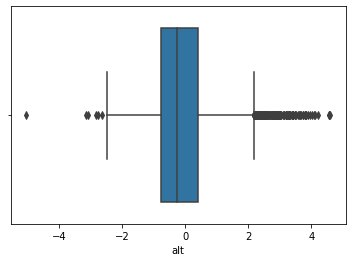

In [32]:
sns.boxplot(x=np.log(merged_data['alt'][merged_data['alt'] > 0]))
out = identify_outliers(np.log(merged_data['alt'][merged_data['alt'] > 0]))
merged_data.loc[out.index, 'alt'] = np.nan

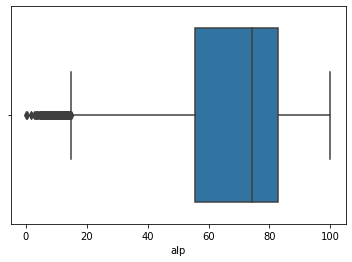

In [33]:
sns.boxplot(x=merged_data['alp'])
out = identify_outliers(merged_data['alp'])
merged_data.loc[out.index, 'alp'] = np.nan

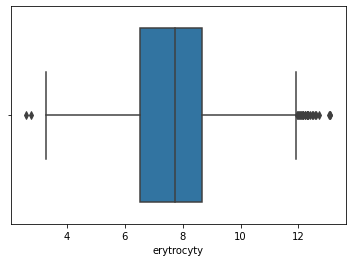

In [34]:
sns.boxplot(x=merged_data['erytrocyty'])
out = identify_outliers(merged_data['erytrocyty'])
merged_data.loc[out.index, 'erytrocyty'] = np.nan

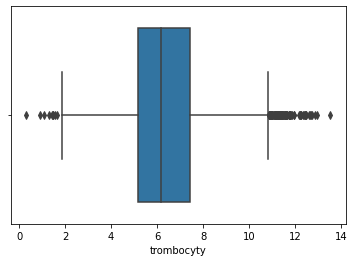

In [35]:
sns.boxplot(x=merged_data['trombocyty'])
out = identify_outliers(merged_data['trombocyty'])
merged_data.loc[out.index, 'trombocyty'] = np.nan

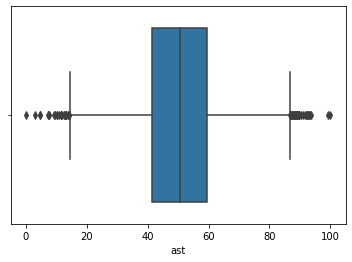

In [36]:
sns.boxplot(x=merged_data['ast'])
out = identify_outliers(merged_data['ast'])
merged_data.loc[out.index, 'ast'] = np.nan

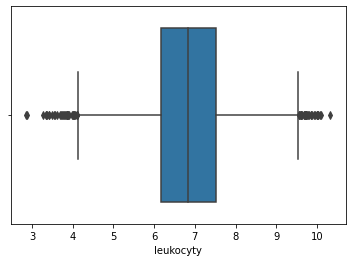

In [37]:
sns.boxplot(x=merged_data['leukocyty'])
out = identify_outliers(merged_data['leukocyty'])
merged_data.loc[out.index, 'leukocyty'] = np.nan

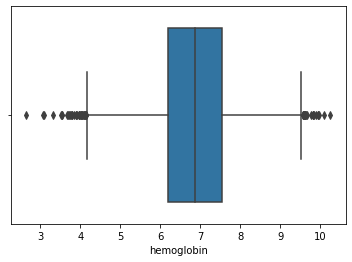

In [38]:
sns.boxplot(x=merged_data['hemoglobin'])
out = identify_outliers(merged_data['hemoglobin'])
merged_data.loc[out.index, 'hemoglobin'] = np.nan

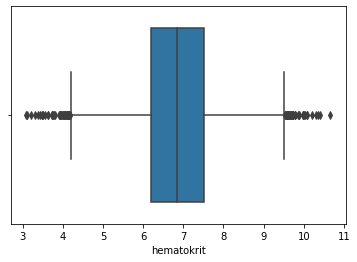

In [39]:
sns.boxplot(x=merged_data['hematokrit'])
out = identify_outliers(merged_data['hematokrit'])
merged_data.loc[out.index, 'hematokrit'] = np.nan

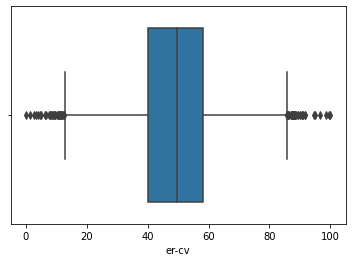

In [40]:
sns.boxplot(x=merged_data['er-cv'])
out = identify_outliers(merged_data['er-cv'])
merged_data.loc[out.index, 'er-cv'] = np.nan

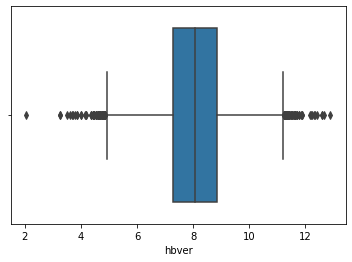

In [41]:
sns.boxplot(x=merged_data['hbver'])
out = identify_outliers(merged_data['hbver'])
merged_data.loc[out.index, 'hbver'] = np.nan

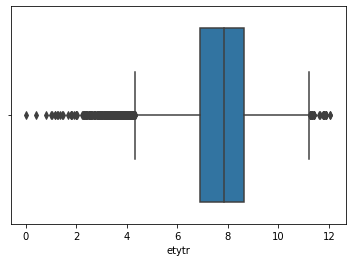

In [42]:
sns.boxplot(x=merged_data['etytr'])
out = identify_outliers(merged_data['etytr'])
merged_data.loc[out.index, 'etytr'] = np.nan

In [43]:
merged_data.head()

,alt,alp,erytrocyty,trombocyty,smoker,ast,leukocyty,weight,ssn,hemoglobin,hematokrit,indicator,name,er-cv,hbver,relationship,etytr,blood_group,sex,birthdate,race,address,company,residence,age
0,2.41434,47.66259,9.16778,9.06523,True,56.18953,7.72328,77.10021,005-10-1507,8.01767,5.27468,1.0,Tim Jackson,56.94903,9.29432,single,8.69227,B-,M,1933-08-19,Hawaiian,"7743 Whitney Field\nNorth Kristinaborough, AK ...",Nelson LLC,51743 Ramos Plaza Apt. 013\nNew Christophermou...,88
1,0.52600,25.44736,6.39544,5.36393,True,33.06488,4.59519,54.86711,005-10-1507,8.48561,5.24169,0.0,Tim Jackson,55.89929,9.03588,widowed,7.81258,B-,M,1933-08-19,Hawaiian,"7743 Whitney Field\nNorth Kristinaborough, AK ...",Nelson LLC,51743 Ramos Plaza Apt. 013\nNew Christophermou...,88
2,0.44887,NaN,6.17123,6.18092,True,29.36710,6.17309,48.94474,005-10-1507,8.69126,7.81749,0.0,Tim Jackson,49.61996,8.31727,single,8.65872,B-,M,1933-08-19,Hawaiian,"7743 Whitney Field\nNorth Kristinaborough, AK ...",Nelson LLC,51743 Ramos Plaza Apt. 013\nNew Christophermou...,88
3,0.44643,36.09296,6.36529,5.48567,False,67.86284,7.69235,79.07111,886-08-5964,8.12416,7.76872,1.0,Michael Jones,30.36222,9.45606,single,6.40610,A-,M,1981-07-16,White,"305 Ramirez Junctions Suite 661\nEast Ashlee, ...","Jones, Bennett and Cruz",2221 Landry Expressway Apt. 191\nSouth Micheal...,40
4,0.25791,58.92836,5.54060,5.27504,True,59.05766,5.62712,37.28702,886-08-5964,7.51701,8.18631,0.0,Michael Jones,39.95466,6.77664,nop,7.04489,A-,M,1981-07-16,White,"305 Ramirez Junctions Suite 661\nEast Ashlee, ...","Jones, Bennett and Cruz",2221 Landry Expressway Apt. 191\nSouth Micheal...,40


### 4.5 Záporné hodnoty

#### Odstránili sme záporné hodnoty zo stĺpcov weight

In [44]:
merged_data.weight[merged_data.weight < 0]

36     -15.26563
76     -12.06564
137    -36.87303
145     -1.55159
158    -55.34818
          ...   
9630    -4.37062
9690   -33.02254
9822   -37.07919
9826   -13.15614
9901    -1.78082
Name: weight, Length: 246, dtype: float64

In [45]:
merged_data.loc[merged_data.weight < 0, 'weight'] = np.nan

In [46]:
merged_data.weight.isnull().sum()

246

### 4.6 Zmena dátových typov

#### Zmenili sme dátový typ stĺpca indicator na typ boolean

In [47]:
merged_data = merged_data.replace({'indicator': {0 : False, 1 : True}})

## 2. Časť

#### Úvodné porovnania

Teplotná mapa korelácií a bodový graf všetkých párov číselných stĺpcov. Teplotná mapa obsahuje navyše aj stĺpce smoker a indicator.

<AxesSubplot:>

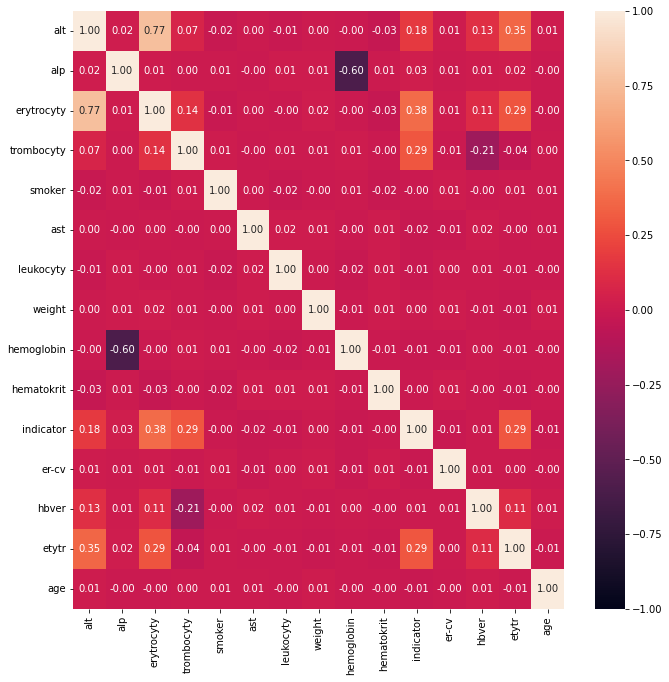

In [48]:
plt.subplots(figsize=(11,11))
sns.heatmap(merged_data.corr(), vmin=-1, vmax=1, annot=True, fmt=".2f")
#sns.heatmap(merged_data.corr(), vmin=-1, vmax=1, annot=True, fmt=".2f")

In [49]:
numeric_cols = [
    'alt','alp','erytrocyty','trombocyty','ast','leukocyty',
    'weight','hemoglobin','hematokrit','er-cv','hbver','etytr','age']

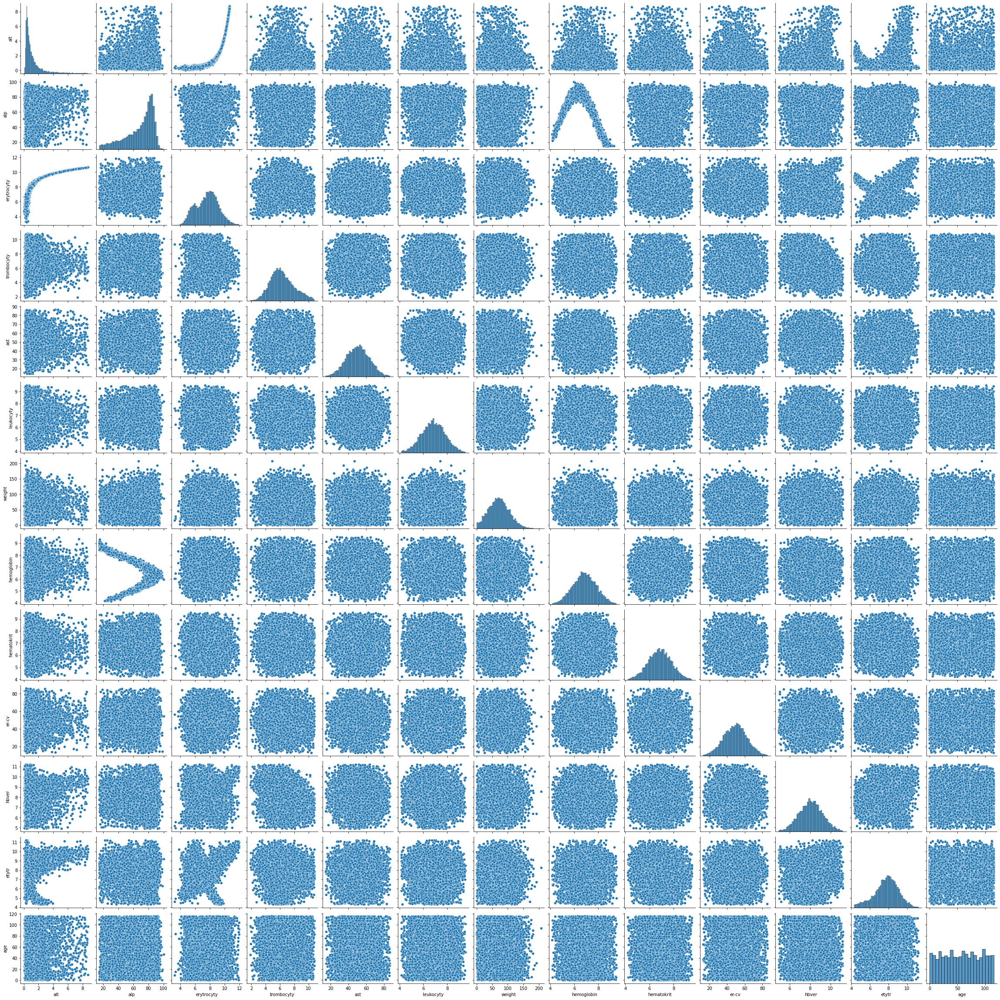

In [50]:
sns.pairplot(merged_data, vars=numeric_cols)

#### Erytrocyty -- ALT

Na bodovom grafe je celkom jasne vidieť vzťah medzi hodnotou erytrocytov a alanín-aminotransferázou (ALT). V snahe zlepšiť koeficient korelácie sme sa pokúsili zlogaritmovať hodnoty ALT kvôli ich exponenciálnemu rastu. Úspešne.

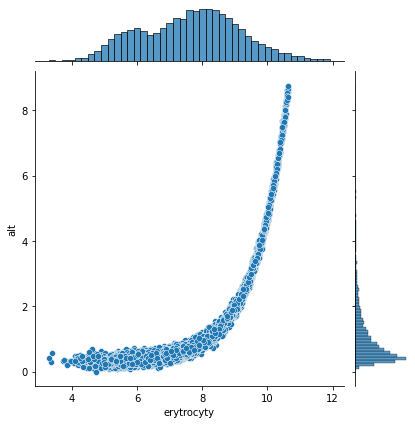

In [51]:
sns.jointplot(data=merged_data, x='erytrocyty', y='alt')

Aplikácia logaritmu:

In [52]:
merged_data.alt[merged_data.alt <= 0]

9618    0.0
Name: alt, dtype: float64

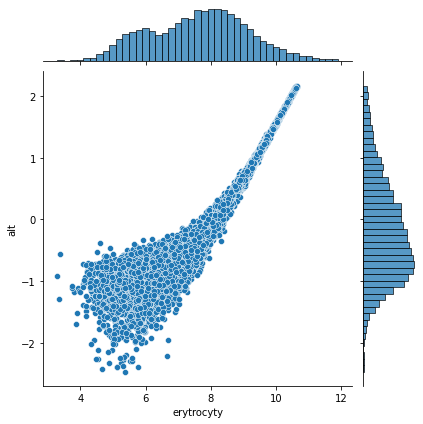

In [53]:
sns.jointplot(x=merged_data.erytrocyty, y=np.log(merged_data.alt[merged_data.alt > 0]))

Koeficient korelácie bez a s použitím logaritmu:

In [54]:
merged_data.erytrocyty.corr(merged_data.alt)

0.7707540618728351

In [55]:
merged_data.erytrocyty.corr(np.log(merged_data.alt[merged_data.alt > 0]))

0.9334029405689035

#### ALP -- hemoglobín
Z bodového grafu vidieť súvislosť medzi hodnotami hemoglobínu a alkalickej fosfatázy (ALP). Najväčšie hodnoty ALP sa dosahujú pri hodnotách hemoglobínu približne 6 až 6,5. Čím je hodnota hemoglobínu vzdialenejšia od týchto hodnôt, tým je hodnota ALP nižšia.

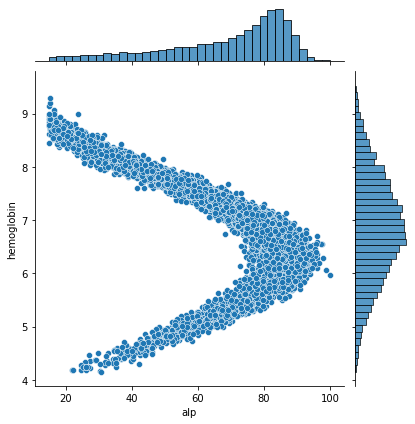

In [56]:
sns.jointplot(data=merged_data, x='alp', y='hemoglobin')

#### Váha -- vek
Človek by od reálnych dát čakal nejakú koreláciu... Čo už, nevadí.

Okrem toho vzorky veku vyzerajú, že pochádzajú z rovnomerného rozdelenia.

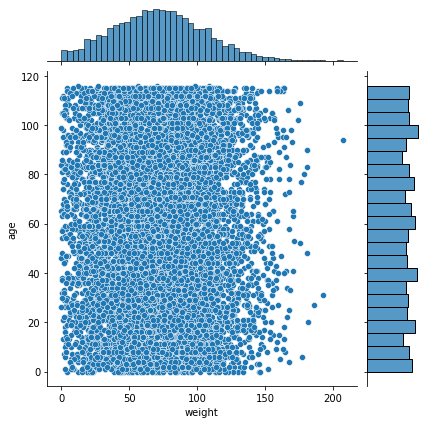

In [57]:
sns.jointplot(data=merged_data, x='weight', y='age')

#### Párové porovnanie so zvýrazneným indikátorom

Znova sa navzájom porovnávajú všetky číselné stĺpce. Tabuľka korelácií naznačila možný vzťah medzi stĺpcami ALT, erytrocyty, trombocyty a etytr. S výnimkou ALT, vo všetkých grafoch s týmito stĺpcami je vidieť nejaké zhluky záznamov s rovnakým indikátorom.

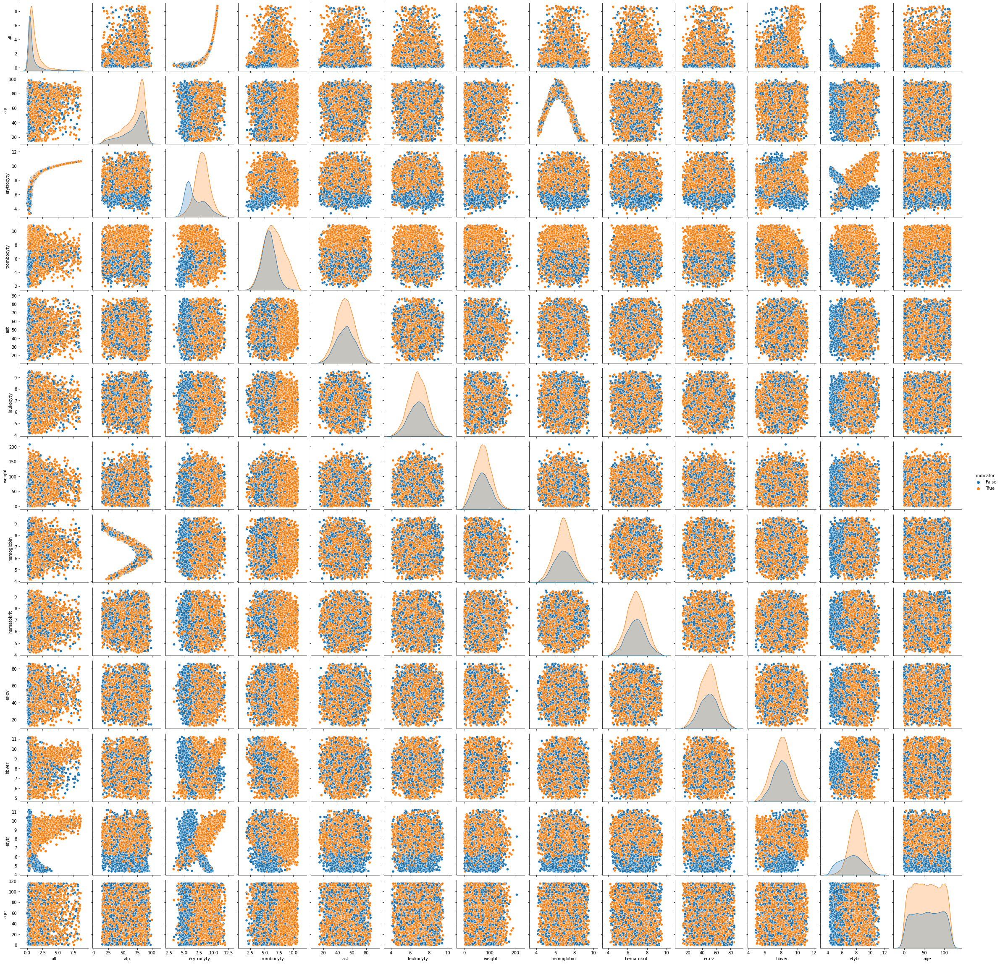

In [58]:
sns.pairplot(merged_data, hue='indicator', vars=numeric_cols)

#### Fajčenie -- indikátor

K prehľadu vyššie sme ešte pridali preskúmanie vzťahu medzi fajčením a indikátorom. Pomocou 4 grafov sme zobrazili podiely fajčiarov v skupinách podľa indikátora, a naopak, podiely indikátorov v skupinách podľa fajčenia. Keďže rovnaké susedné skupiny majú veľmi malý rozdiel v podieloch, vzťah medzi týmito premennými pravdepodobne nie je. To podporuje aj takmer nulový koeficient korelácie vypočítaný v tabuľke vyššie.

indicator,neindikovaní,indikovaní
smoker,,
False,2133,3823
True,1415,2491


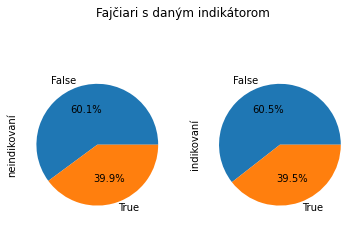

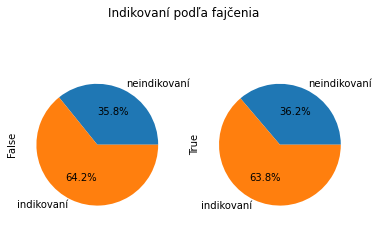

In [59]:
a = pd.crosstab(index=merged_data['smoker'], columns=merged_data['indicator']) \
    .rename(index={'N':'nefajčiari', 'Y':'fajčíari'}, columns={0:'neindikovaní', 1:'indikovaní'})
a.plot(kind='pie', subplots=True, title='Fajčiari s daným indikátorom', legend=False, autopct="%.1f%%")
a.T.plot(kind='pie', subplots=True, title='Indikovaní podľa fajčenia', legend=False, autopct="%.1f%%")
a

#### Erytrocyty - etytr - indikátor

Bodový graf erytrocytov a "etytr" zafarbený podľa indikátora vyzerá, ako keby sa skladal z 2 samostatných grafov. Rozdelili sme teda tento graf do 2 samostatných grafov. Väčšina bodov v rozdelených grafoch patrí do "svojho" zhluku, ale nachádzajú sa tu aj vychýlené body, ktoré by vizuálne mohli patriť do zhluku opačného indikátora.

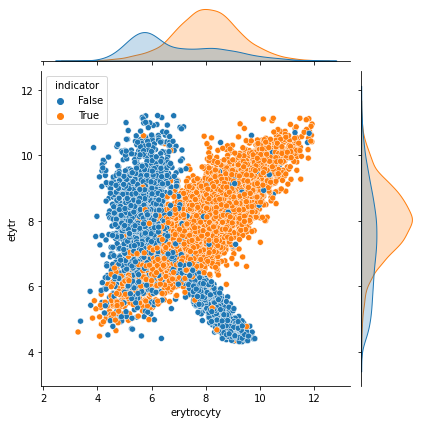

In [60]:
sns.jointplot(data=merged_data, x='erytrocyty', y='etytr', hue='indicator')

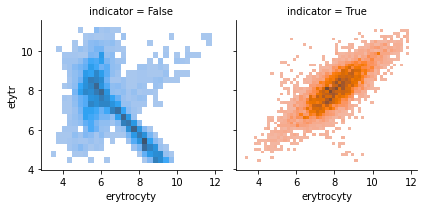

In [61]:
g = sns.FacetGrid(merged_data, col='indicator', hue='indicator')
g.map(sns.histplot, 'erytrocyty', 'etytr')

#### ALT - etytr - indikátor

Podobne ako graf erytocytov a etytr podľa indikátora, aj graf ALT a etytr podľa indikátora vyzerá, ako keby vznikol zlúčením 2 jednoduchších grafov.

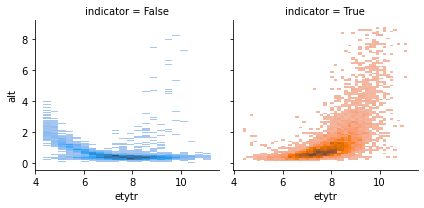

In [62]:
p = sns.FacetGrid(merged_data, col='indicator', hue='indicator')
p.map(sns.histplot, 'etytr', 'alt')

#### Ďalšie porovnania podľa kategórií

Pokúsili sme sa porovnať číselné veličiny aj podľa iných kategorických veličín ako je indikátor. Žiadny viditeľný vzťah sme pri nich ale nezbadali. Nakoniec uvádzame iba párové grafy podľa fajčiarov. Porovnávali sme aj párové grafy podľa pohlavia, krvnej skupiny a rasy.

#### Podľa fajčiarov

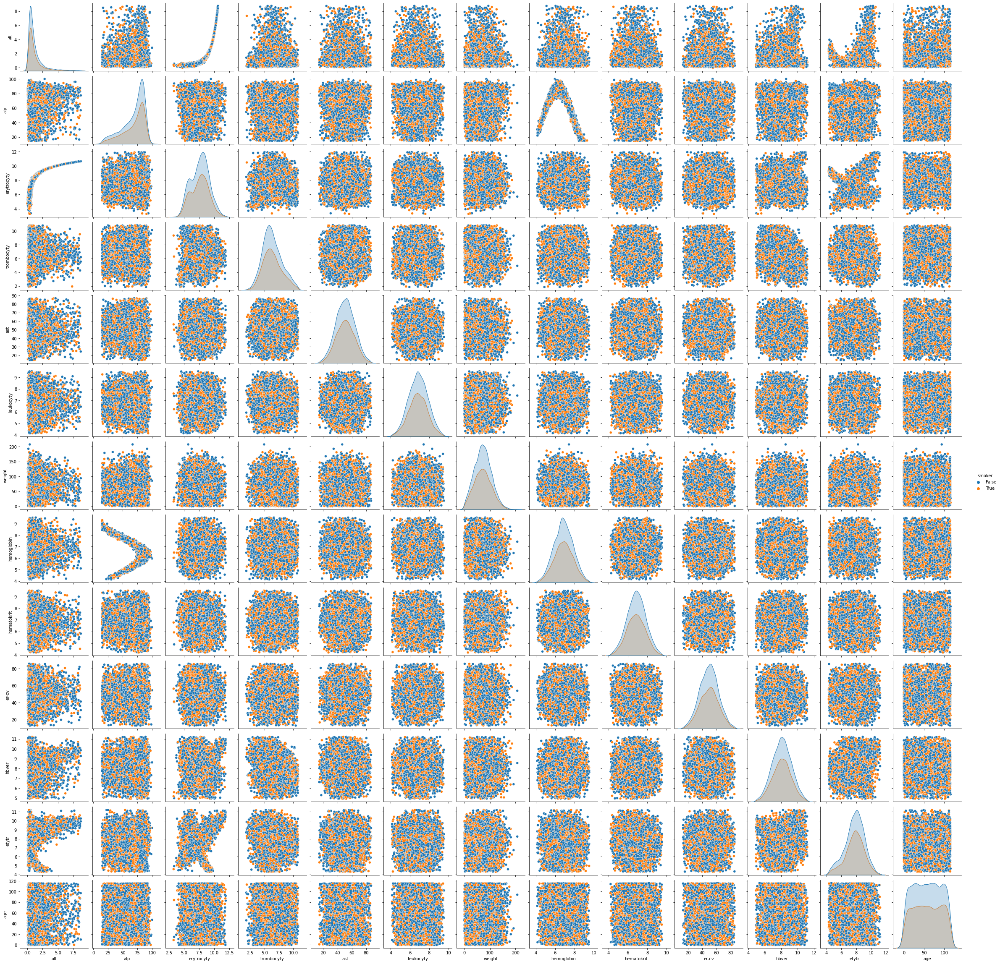

In [63]:
sns.pairplot(merged_data, hue='smoker', vars=numeric_cols)

## 3.Časť

### 3.1 Hypotéza 1

$H_0$: Hodnota erytrocytov u indikovaných pacientov je **rovnaká** od hodnoty neindikovaných pacientov.

$H_1$: Hodnota erytrocytov u indikovaných pacientov je **rozdielna** od hodnoty neindikovaných pacientov.

<AxesSubplot:xlabel='erytrocyty', ylabel='Count'>

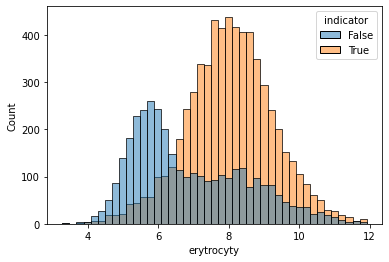

In [66]:
sns.histplot(data=merged_data, x='erytrocyty', hue='indicator')

Overenie predpokladov pre **Studentov T-test**: Shapiro-Wilkov test normálnosti a Levenov test podobnosti variancií.

In [67]:
erytrocyt0 = merged_data.erytrocyty[merged_data.indicator == 0.0].dropna()
erytrocyt1 = merged_data.erytrocyty[merged_data.indicator == 1.0].dropna()

In [68]:
stats.shapiro(erytrocyt0)

ShapiroResult(statistic=0.9439687728881836, pvalue=1.1661922186220744e-34)

In [69]:
stats.shapiro(erytrocyt1)

/home/matus/.local/lib/python3.8/site-packages/scipy/stats/morestats.py:1760: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


ShapiroResult(statistic=0.9977995157241821, pvalue=7.613804342554431e-08)

In [70]:
stats.levene(erytrocyt0, erytrocyt1)

LeveneResult(statistic=376.65446761444906, pvalue=2.309497513720434e-82)

Testy na normálnosť a variancie neprešli (pvalue < 0.05), rozdelenia nie sú normálne a majú rozdielne variancie. Použijeme **Mann-Whiteneyho U-test**.

In [71]:
stats.mannwhitneyu(erytrocyt0, erytrocyt1)

MannwhitneyuResult(statistic=6135993.5, pvalue=3.3047287675455583e-295)

**Výsledok**: Hodnota erytrocytov u indikovaných pacientov je rozdielna od hodnoty neindikovaných pacientov. $H_0$ zamietame v prospech $H_1$.

### 3.2 Hypotéza 2

$H_0$: Hodnota trombocytov u indikovaných pacientov je **rovnaká** od hodnoty neindikovaných pacientov.

$H_1$: Hodnota trombocytov u indikovaných pacientov je **rozdielna** od hodnoty neindikovaných pacientov.

<AxesSubplot:xlabel='trombocyty', ylabel='Count'>

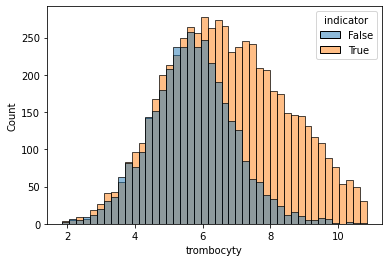

In [72]:
sns.histplot(data=merged_data, x='trombocyty', hue='indicator')

In [73]:
trombocyt0 = merged_data.trombocyty[merged_data.indicator == 0.0].dropna()
trombocyt1 = merged_data.trombocyty[merged_data.indicator == 1.0].dropna()

Testy na normálnosť a variancie neprešli (pvalue < 0.05), rozdelenia nie sú normálne a majú rozdielne variancie. Znova použijeme **Mann-Whiteneyho U-test**.

In [74]:
stats.shapiro(trombocyt0)

ShapiroResult(statistic=0.9962195754051208, pvalue=8.508266802209619e-08)

In [75]:
stats.shapiro(trombocyt1)

/home/matus/.local/lib/python3.8/site-packages/scipy/stats/morestats.py:1760: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


ShapiroResult(statistic=0.9917566180229187, pvalue=1.7203997062971092e-18)

In [76]:
stats.levene(trombocyt0, trombocyt1)

LeveneResult(statistic=600.0822247912445, pvalue=1.2300551465471368e-128)

In [77]:
stats.mannwhitneyu(trombocyt0, trombocyt1)

MannwhitneyuResult(statistic=7135692.0, pvalue=8.799949853954366e-177)

**Výsledok**: Hodnota trombocytov u indikovaných pacientov je rozdielna od hodnoty neindikovaných pacientov. $H_0$ zamietame v prospech $H_1$.

----
# 2. fáza

V tejto fáze sa od Vás očakáva:

* Realizujte predspracovanie údajov pre strojové učenie. Výsledkom bude upravená dátová sada vo formáte csv alebo tsv, kde jedno pozorovanie musí byť opísané jedným riadkom.
* V 3. fáze budeme pracovať s algoritmami strojového učenia, ktorých implementácia v scikit-learn podporuje len numerické dáta. To vedie k tomu že treba niečo spraviť s nenumerickými dátami.
* Replikovateľnosť predspracovania na trénovacej a testovacej množine dát.

Keď sa predspracovaním mohol zmeniť tvar a charakteristiky dát (počet atribútov, distribúcie hodnôt a pod.), je možné že treba znovu zrealizovať podstatné časti prieskumnej analýzy a opakovane podľa Vašej potreby. Bodovanie znovu za EDA už nebudeme, zmeny ale zdokumentujte. Problém s dátami môžete riešiť iteratívne v každej fáze aj vo všetkých fázach podľa vlastnej potreby.
 
**1. Integrácia a čistenie dát (5b)**
  
  Transformujte dáta na vhodný formát pre strojové učenie t.j. jedno pozorovanie musí byť opísané jedným riadkom a každý atribút musí byť v numerickom formáte.
  
  * Pri riešení chýbajúcich hodnôt (missing values) vyskúšajte rôzne stratégie z nasledujúcich podskupín:
    * odstránenie pozorovaní s chýbajúcimi údajmi
    * nahradenie chýbajúcej hodnoty mediánom, priemerom, pomerom (ku korelovanému atribútu), alebo pomocou lineárnej regresie resp. kNN
  * Podobne postupujte aj pri riešení vychýlených hodnôt (outlier detection):
    * odstránenie vychýlených (odľahlých) pozorovaní
    * nahradenie vychýlenej hodnoty hraničnými hodnotami rozdelenia (5% resp. 95%)


**2. Realizácia predspracovania dát (5b)**

  * Transformované dáta pre strojové učenie si rozdeľuje na trénovaciu a testovaciu množinu (train and test dataset) podľa vami preddefinovaným pomerom. Naďalej pracujte len s trénovacím datasetom.
  * Transformujte atribútov dát pre strojové učenie podľa dostupných techník (minimálne 2 techniky) ako scaling, transformers a ďalšie.
  * Zdôvodnite Vašu voľby/rozhodnutie pre realizáciu (t.j. zdokumentovanie)


**3. Výber atribútov pre strojové učenie (5b)**

  * Zistite ktoré atribúty (features) vo vašich dátach pre strojové učenie sú informatívne k atribútu “indikator”.
  * Zoradíte tie atribúty v poradí podľa dôležitosti. 
  * Zdôvodnite Vašu voľby/rozhodnutie pre realizáciu (t.j. zdokumentovanie) 


**4. Replikovateľnosť predspracovania (5b)**

  * Upravte váš kód realizujúci predspracovanie trénovacej množiny tak, aby ho bolo možné bez ďalších úprav znovu použiť na predspracovanie testovacej množiny (napr. pomocou funkcie/í)
  * Očakáva sa aj využitie možnosti sklearn.pipeline
----

## Otázky

1. Dopĺňanie nullových hodnôt -- všetky metódy alebo len nejaké? Lineárna regresia, kNN?

2. Kedy deliť dáta? Pred 2. časťou alebo aj pred 1.? (priemer, medián, atď. sa počíta z oboch množín)

----

Pripravenie dát pre túto fázu. Z predchádzajúcej fázy bolo použité:
  * načítanie dát
  * spojenie do jednej tabuľky
  * odstránenie duplikátov
  * formátovanie dátumov
  * výpočet veku
  * identifikácia outlierov

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import scipy.stats as stats
from datetime import datetime
from datetime import date
import matplotlib.pyplot as plt
from sklearn.preprocessing import RobustScaler
import category_encoders as ce

pd.set_option('max_columns', None)

labor = pd.read_csv('055/labor.csv', sep='\t', header=0, index_col=0)
profiles = pd.read_csv('055/profiles.csv', sep='\t', header=0, index_col=0)

data = labor.merge(profiles, on='ssn', how='outer')
data = data.drop(columns='name_y').rename(columns={'name_x':'name'})

data = data.drop_duplicates()

data['birthdate'] = pd.to_datetime(data['birthdate'])

def calculate_age(born):
    today = date.today()
    return today.year - born.year - ((today.month, today.day) < (born.month, born.day))
data['age'] = data['birthdate'].apply(calculate_age)

def identify_outliers(a):
    lower = a.quantile(0.25) - 1.5 * stats.iqr(a.dropna())
    upper = a.quantile(0.75) + 1.5 * stats.iqr(a.dropna())
    return a[(a > upper) | (a < lower)]

In [ ]:
# Záporná váha
#merged_data.loc[merged_data.weight < 0, 'weight'] = np.nan

# Outliere
#out = identify_outliers(np.log(merged_data['alt'][merged_data['alt'] > 0]))
#merged_data.loc[out.index, 'alt'] = np.nan

# Nahradenie kategórie na boolean
#merged_data = merged_data.replace({'indicator': {0 : False, 1 : True}})

## 1. Integrácia a čistenie dát

In [52]:
data.isnull().sum()

alt             30
alp             30
erytrocyty      30
trombocyty      30
smoker           0
ast             30
leukocyty       30
weight           0
ssn              0
hemoglobin      30
hematokrit      30
indicator        0
name             0
er-cv           30
hbver           30
relationship     0
etytr           30
blood_group      0
sex              0
birthdate        0
race             0
address          0
company          0
residence        0
age              0
dtype: int64

Odstránenie riadkov s 2 a viac NaN hodnotami:

In [53]:
data.isnull().sum(axis=1).value_counts()

0    9537
1     320
2       5
dtype: int64

In [54]:
data = data.drop(data[data.isnull().sum(axis=1) >= 2].index)
data.isnull().sum(axis=1).value_counts()

0    9537
1     320
dtype: int64

Nahradenie priemerom:

In [55]:
print(data.hemoglobin.mean())
data.hemoglobin = data.hemoglobin.fillna(data.hemoglobin.mean())
print(data.hemoglobin.isnull().sum())

6.852576369186934
0


Nahradenie mediánom:

In [56]:
print(data.alt.median())
data.alt = data.alt.fillna(data.alt.median())
print(data.alt.isnull().sum())

0.77607
0


Nahradenie pomerom:

Nahradenie lineárnou regresiou:

Nahradenie kNN:

In [30]:
from sklearn.impute import KNNImputer

imputer = KNNImputer()
d = pd.DataFrame(data.alp)
imputer.fit(d)
d = imputer.transform(d)
d = pd.DataFrame(d)

print(d.isnull().sum())
d2 = d.join(data.alp)
print(d2[d2['alp'] == d2[0]])

0    0
dtype: int64
            0       alp
0    47.66259  47.66259
1    25.44736  25.44736
2    11.49107  11.49107
3    36.09296  36.09296
4    58.92836  58.92836
..        ...       ...
139  70.96659  70.96659
140  42.22792  42.22792
141  74.72427  74.72427
142  66.53598  66.53598
143  80.96384  80.96384

[142 rows x 2 columns]


## 2. Realizácia predspracovania dát

In [8]:
train = data.sample(frac=0.67,random_state=len(data))
test = data.drop(train.index)
len(train)

6608

In [9]:
len(test)

3254

In [35]:
data['race'] = data['race'].replace({'black' : 'Black', 'blsck' : 'Black', 'white' : 'White'})
data.race.value_counts()

White       4845
Black       2977
Asian       1023
Indian       514
Hawaiian     503
Name: race, dtype: int64

In [2]:
ce_ordinal = ce.OrdinalEncoder(cols=['race'])
data = ce_ordinal.fit_transform(data)

/home/matus/.local/lib/python3.8/site-packages/category_encoders/utils.py:21: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  elif pd.api.types.is_categorical(cols):


In [37]:
data.race.value_counts()

2    4845
3    2977
4    1023
5     514
1     503
Name: race, dtype: int64

In [38]:
data.sex.value_counts()

F    5059
M    4803
Name: sex, dtype: int64

In [3]:
ce_OHE = ce.OneHotEncoder(cols=['sex'])
data = ce_OHE.fit_transform(data)

In [40]:
data.sex_1.value_counts()

0    5059
1    4803
Name: sex_1, dtype: int64

In [41]:
data.sex_2.value_counts()

1    5059
0    4803
Name: sex_2, dtype: int64

In [4]:
data['smoker'] = data['smoker'].replace({'yes' : True, 'Y' : True, 'no' : False, 'N' : False})
print(data.smoker.value_counts())
ce_ordinal = ce.OrdinalEncoder(cols=['smoker'])
data = ce_ordinal.fit_transform(data)
print(data.smoker.value_counts())

False    5956
True     3906
Name: smoker, dtype: int64
2    5956
1    3906
Name: smoker, dtype: int64


In [5]:
ce_ordinal = ce.OrdinalEncoder(cols=['blood_group'])
data = ce_ordinal.fit_transform(data)

## 3. časť

In [44]:
data.columns

Index(['alt', 'alp', 'erytrocyty', 'trombocyty', 'smoker', 'ast', 'leukocyty',
       'weight', 'ssn', 'hemoglobin', 'hematokrit', 'indicator', 'name',
       'er-cv', 'hbver', 'relationship', 'etytr', 'blood_group', 'sex_1',
       'sex_2', 'birthdate', 'race', 'address', 'company', 'residence', 'age'],
      dtype='object')

In [7]:
from sklearn.feature_selection import RFE
from sklearn.svm import SVR

d = data.dropna();

d = d.sample(500);
print(d.shape)

ix = [i for i in d.columns if i not in ['indicator', 'ssn', 'name', 'relationship', 'address', 'company', 'residence', 'birthdate']]
X, y = d[ix], d['indicator']

estimator = SVR(kernel="linear")
selector = RFE(estimator, n_features_to_select=1, step=1)
selector = selector.fit(X, y)

print(selector.support_)
print(selector.ranking_)

(500, 26)
[False False False False False False False False False False False False
  True False False False False False]
[ 4 13  3  2 10 17  9 18 12  7 14 11  1 15  8  5  6 16]


In [14]:
for i in range(len(ix)):
    print(i, ix[i], selector.ranking_[i])

0 alt 4
1 alp 13
2 erytrocyty 3
3 trombocyty 2
4 smoker 10
5 ast 17
6 leukocyty 9
7 weight 18
8 hemoglobin 12
9 hematokrit 7
10 er-cv 14
11 hbver 11
12 etytr 1
13 blood_group 15
14 sex_1 8
15 sex_2 5
16 race 6
17 age 16
